<a href="https://colab.research.google.com/github/rgnemasters/TechInterviews/blob/main/LPLAssessment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Mount Drive and Import Libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [54]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


#Load and View Files

##Main Dataset

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Datasets/public_150k_plus_220403.csv')

In [ ]:
display(df.head())
df.info()

,LoanNumber,DateApproved,SBAOfficeCode,ProcessingMethod,BorrowerName,BorrowerAddress,BorrowerCity,BorrowerState,BorrowerZip,LoanStatusDate,...,BusinessType,OriginatingLenderLocationID,OriginatingLender,OriginatingLenderCity,OriginatingLenderState,Gender,Veteran,NonProfit,ForgivenessAmount,ForgivenessDate
0,9547507704,05/01/2020,464,PPP,"SUMTER COATINGS, INC.",2410 Highway 15 South,Sumter,NaN,29150-9662,12/18/2020,...,Corporation,19248,Synovus Bank,COLUMBUS,GA,Unanswered,Unanswered,NaN,773553.37,11/20/2020
1,9777677704,05/01/2020,464,PPP,"PLEASANT PLACES, INC.",7684 Southrail Road,North Charleston,NaN,29420-9000,09/28/2021,...,Sole Proprietorship,19248,Synovus Bank,COLUMBUS,GA,Male Owned,Non-Veteran,NaN,746336.24,08/12/2021
2,5791407702,05/01/2020,1013,PPP,BOYER CHILDREN'S CLINIC,1850 BOYER AVE E,SEATTLE,NaN,98112-2922,03/17/2021,...,Non-Profit Organization,9551,"Bank of America, National Association",CHARLOTTE,NC,Unanswered,Unanswered,Y,696677.49,02/10/2021
3,6223567700,05/01/2020,920,PPP,KIRTLEY CONSTRUCTION INC,1661 MARTIN RANCH RD,SAN BERNARDINO,NaN,92407-1740,10/16/2021,...,Corporation,9551,"Bank of America, National Association",CHARLOTTE,NC,Male Owned,Non-Veteran,NaN,395264.11,09/10/2021
4,9662437702,05/01/2020,101,PPP,AERO BOX LLC,NaN,NaN,NaN,NaN,08/17/2021,...,NaN,57328,The Huntington National Bank,COLUMBUS,OH,Unanswered,Unanswered,NaN,370819.35,04/08/2021


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 968532 entries, 0 to 968531
Data columns (total 53 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   LoanNumber                   968532 non-null  int64  
 1   DateApproved                 968532 non-null  object 
 2   SBAOfficeCode                968532 non-null  int64  
 3   ProcessingMethod             968532 non-null  object 
 4   BorrowerName                 968528 non-null  object 
 5   BorrowerAddress              968518 non-null  object 
 6   BorrowerCity                 968520 non-null  object 
 7   BorrowerState                968519 non-null  object 
 8   BorrowerZip                  968519 non-null  object 
 9   LoanStatusDate               835016 non-null  object 
 10  LoanStatus                   968532 non-null  object 
 11  Term                         968532 non-null  int64  
 12  SBAGuarantyPercentage        968532 non-null  int64  
 13 

In [ ]:
#Reviewing values for "ForgivenessDate" to determine if each loan in DF is a forgiven loan
df['ForgivenessDate'].isna().sum()

93711

In [ ]:
df['LoanStatus'].value_counts(dropna=False)

Paid in Full           835009
Exemption 4            133516
Active Un-Disbursed         7
NaN                         1
Name: LoanStatus, dtype: int64

In [ ]:
#Review beginning dates of loans to determine timeframe covered
df.sort_values(by='DateApproved', ascending=False)

,LoanNumber,DateApproved,SBAOfficeCode,ProcessingMethod,BorrowerName,BorrowerAddress,BorrowerCity,BorrowerState,BorrowerZip,LoanStatusDate,...,BusinessType,OriginatingLenderLocationID,OriginatingLender,OriginatingLenderCity,OriginatingLenderState,Gender,Veteran,NonProfit,ForgivenessAmount,ForgivenessDate
868291,7190847110,12/14/2020,669,PPP,D WG FM INC,PO BOX 570426,HOUSTON,TX,77257-0427,NaN,...,Corporation,39848,Cadence Bank,TUPELO,MS,Unanswered,Unanswered,NaN,NaN,NaN
847968,7007237107,12/08/2020,669,PPP,AHD HOUSTON INC,P.O. Box 570427,HOUSTON,TX,77257-0427,NaN,...,Corporation,39848,Cadence Bank,TUPELO,MS,Unanswered,Unanswered,NaN,NaN,NaN
516021,9308647104,12/08/2020,470,PPP,D HOUSTON INC,12481 GLASCOCK DR,GULFPORT,MS,39503,NaN,...,Corporation,39848,Cadence Bank,TUPELO,MS,Unanswered,Unanswered,NaN,NaN,NaN
515852,6623207108,12/08/2020,470,PPP,D WESTWOOD INC,12481 GLASCOCK DR,GULFPORT,MS,39503,NaN,...,Corporation,39848,Cadence Bank,TUPELO,MS,Unanswered,Unanswered,NaN,NaN,NaN
788,5575278201,08/08/2020,1084,PPP,ALASKA WEATHER OPERATIONS SERVICES INC,4235 AIRCRAFT DR BLDG C,ANCHORAGE,AK,99502-0907,02/12/2022,...,Subchapter S Corporation,56102,KeyBank National Association,CLEVELAND,OH,Unanswered,Unanswered,NaN,454228.77,08/02/2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
846218,9910168210,01/13/2021,677,PPP,JAR CONCRETE INC DBA JAR CONSTRUCTION INC,8000 Escobar Dr,El Paso,TX,79907-1854,09/29/2021,...,Corporation,105986,GECU,EL PASO,TX,Unanswered,Unanswered,NaN,313613.32,06/15/2021
826031,9912088203,01/13/2021,677,PPP,PASO DEL NORTE MATERIALS LLC,8000 Escobar Dr,El Paso,TX,79907-1854,09/25/2021,...,Limited Liability Company(LLC),105986,GECU,EL PASO,TX,Unanswered,Unanswered,NaN,641751.93,06/23/2021
364893,9910208209,01/13/2021,562,PPS,"CABINETS PLUS BY PATRICK GEER, INC.",6406 Production Dr,Anderson,IN,46013-9408,08/20/2021,...,Corporation,473200,"Flagship Enterprise Center, Inc. (dba Bankable)",Anderson,IN,Male Owned,Non-Veteran,NaN,177286.27,08/11/2021
495262,9910338202,01/13/2021,508,PPP,MINNESOTA TECHNOLOGY ASSOCIATION,400 S 4th St Ste 416,Minneapolis,MN,55415-1400,09/14/2021,...,501(c)6 – Non Profit Membership,38858,"Sunrise Banks, National Association",SAINT PAUL,MN,Unanswered,Unanswered,Y,183987.70,08/06/2021


In [ ]:
#Determine range of loan amounts
round(df[['InitialApprovalAmount', 'CurrentApprovalAmount']].describe(), 2)

,InitialApprovalAmount,CurrentApprovalAmount
count,968532.00,968532.00
mean,532255.17,530623.61
std,744251.23,737886.86
min,0.00,150000.00
25%,200200.00,200400.00
50%,295178.75,295000.00
75%,540200.00,539389.75
max,10000000.00,10000000.00


In [ ]:
#Confirm that these loans are all part of the SBA
df['SBAGuarantyPercentage'].value_counts(dropna=False)

100.0    968532
NaN           1
Name: SBAGuarantyPercentage, dtype: int64

##NAICS Dataset

In [ ]:
codes_df = pd.read_excel('/content/drive/MyDrive/Datasets/6-digit_2017_Codes.xlsx')

In [ ]:
codes_df.head()

,2017 NAICS Code,2017 NAICS Title,Unnamed: 2
0,NaN,NaN,NaN
1,111110.0,Soybean Farming,NaN
2,111120.0,Oilseed (except Soybean) Farming,NaN
3,111130.0,Dry Pea and Bean Farming,NaN
4,111140.0,Wheat Farming,NaN


In [ ]:
codes_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1058 entries, 0 to 1057
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   2017 NAICS Code   1057 non-null   float64
 1   2017 NAICS Title  1057 non-null   object 
 2   Unnamed: 2        1 non-null      object 
dtypes: float64(1), object(2)
memory usage: 24.9+ KB


In [ ]:
#Review single non-null value in Unnamed category to confirm column can be dropped.
codes_df[codes_df['Unnamed: 2'].isna() == False]

,2017 NAICS Code,2017 NAICS Title,Unnamed: 2
6,111160.0,Rice Farming,


#Join Tables

In [ ]:
#Format join index to prep for merge
codes_df.rename(columns={'2017 NAICS Code': 'NAICSCode'}, inplace=True)

In [ ]:
df = df.merge(codes_df, how='outer')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 968533 entries, 0 to 968532
Data columns (total 55 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   LoanNumber                   968532 non-null  float64
 1   DateApproved                 968532 non-null  object 
 2   SBAOfficeCode                968532 non-null  float64
 3   ProcessingMethod             968532 non-null  object 
 4   BorrowerName                 968528 non-null  object 
 5   BorrowerAddress              968518 non-null  object 
 6   BorrowerCity                 968520 non-null  object 
 7   BorrowerState                968519 non-null  object 
 8   BorrowerZip                  968519 non-null  object 
 9   LoanStatusDate               835016 non-null  object 
 10  LoanStatus                   968532 non-null  object 
 11  Term                         968532 non-null  float64
 12  SBAGuarantyPercentage        968532 non-null  float64
 13 

In [ ]:
df.drop(columns='Unnamed: 2', inplace=True)

In [ ]:
pd.set_option("display.max_rows", None)

In [ ]:
df['2017 NAICS Title'].isna().sum()

12179

In [ ]:
df[df['2017 NAICS Title'].isna() == True]

,LoanNumber,DateApproved,SBAOfficeCode,ProcessingMethod,BorrowerName,BorrowerAddress,BorrowerCity,BorrowerState,BorrowerZip,LoanStatusDate,...,OriginatingLenderLocationID,OriginatingLender,OriginatingLenderCity,OriginatingLenderState,Gender,Veteran,NonProfit,ForgivenessAmount,ForgivenessDate,2017 NAICS Title
7783,5.791408e+09,05/01/2020,1013.0,PPP,BOYER CHILDREN'S CLINIC,1850 BOYER AVE E,SEATTLE,NaN,98112-2922,03/17/2021,...,9551.0,"Bank of America, National Association",CHARLOTTE,NC,Unanswered,Unanswered,Y,696677.49,02/10/2021,NaN
7784,4.978128e+09,05/01/2020,1084.0,PPP,NIM INC,4681 E SHORELINE CIR,WASILLA,AK,99654-6661,08/19/2021,...,9551.0,"Bank of America, National Association",CHARLOTTE,NC,Unanswered,Unanswered,NaN,210367.22,07/15/2021,NaN
7785,4.750618e+09,05/01/2020,1084.0,PPP,BRISTOL BAY FUELS LLC,5015 BUSINESS PARK BLVD. SUITE 4000,ANCHORAGE,AK,99503,08/12/2021,...,12096.0,"Wells Fargo Bank, National Association",SIOUX FALLS,SD,Unanswered,Unanswered,NaN,198959.38,07/02/2021,NaN
7786,4.893778e+09,05/01/2020,1084.0,PPP,ESSENTIAL MEDICAL MANAGEMENT LLC,401 N. MAIN STREET # 0736,WASILLA,AK,99687,NaN,...,12096.0,"Wells Fargo Bank, National Association",SIOUX FALLS,SD,Unanswered,Unanswered,NaN,21213.70,03/07/2022,NaN
7787,3.312198e+09,05/01/2020,1084.0,PPP,"NORTHERN LIGHTS BUSINESS, INC.",60 College Rd,Fairbanks,AK,99701-1706,07/15/2021,...,223542.0,Celtic Bank Corporation,SALT LAKE CITY,UT,Male Owned,Non-Veteran,NaN,187315.56,06/14/2021,NaN
7788,4.727348e+09,05/01/2020,1084.0,PPP,COFFMAN DENTAL,351 W SWANSON AVE,WASILLA,AK,99654,06/09/2021,...,12096.0,"Wells Fargo Bank, National Association",SIOUX FALLS,SD,Unanswered,Unanswered,NaN,155958.08,05/12/2021,NaN
7789,2.176448e+09,05/01/2020,459.0,PPP,"MICRONET IT SOLUTIONS, INC",8415 Crossland Loop,Montgomery,AL,36117,08/20/2021,...,48270.0,"JPMorgan Chase Bank, National Association",COLUMBUS,OH,Unanswered,Unanswered,NaN,3153410.93,07/09/2021,NaN
7790,9.796978e+09,05/01/2020,459.0,PPP,PARKER & SON INC,9594 Hwy 31,ATMORE,AL,36502-5634,06/11/2021,...,19248.0,Synovus Bank,COLUMBUS,GA,Unanswered,Unanswered,NaN,1729156.46,05/11/2021,NaN
7791,9.642818e+09,05/01/2020,459.0,PPP,MONDRAGON ENTERPRISES,8469 Hwy 47,Shelby,AL,35143,07/14/2021,...,2408.0,Regions Bank,BIRMINGHAM,AL,Unanswered,Unanswered,NaN,1010931.51,06/11/2021,NaN
7792,9.744008e+09,05/01/2020,459.0,PPP,AABAMA CHRISTIAN ACADEMY,4700 Wares Ferry Road,Montgomery,AL,36109-3304,06/11/2021,...,19248.0,Synovus Bank,COLUMBUS,GA,Unanswered,Unanswered,Y,921089.61,06/01/2021,NaN


In [ ]:
df['2017 NAICS Title'].value_counts(dropna=False)

Full-Service Restaurants                                                                                                   76551
Offices of Physicians (except Mental Health Specialists)                                                                   28309
Offices of Lawyers                                                                                                         19996
Hotels (except Casino Hotels) and Motels                                                                                   19204
Plumbing, Heating, and Air-Conditioning Contractors                                                                        18364
Offices of Dentists                                                                                                        17619
Commercial and Institutional Building Construction                                                                         17376
Limited-Service Restaurants                                                                      

In [ ]:
#Determine the number of loans issued to companies in Poway, CA
df['BorrowerCity'].str.contains('Poway').sum()

124

In [50]:
#Check to make sure Poway is only a CA city
poway = df['BorrowerCity'] == 'Poway'
df[poway].groupby('BorrowerState')['BorrowerCity'].count()

BorrowerState
CA    123
Name: BorrowerCity, dtype: int64

In [88]:
df[df['BorrowerCity'] == 'Poway']

,LoanNumber,DateApproved,SBAOfficeCode,ProcessingMethod,BorrowerName,BorrowerAddress,BorrowerCity,BorrowerState,BorrowerZip,LoanStatusDate,...,OriginatingLenderLocationID,OriginatingLender,OriginatingLenderCity,OriginatingLenderState,Gender,Veteran,NonProfit,ForgivenessAmount,ForgivenessDate,2017 NAICS Title


#Data Analysis

In [58]:
round(df['InitialApprovalAmount'].describe(), 2)

count      968532.00
mean       532255.17
std        744251.23
min             0.00
25%        200200.00
50%        295178.75
75%        540200.00
max      10000000.00
Name: InitialApprovalAmount, dtype: float64

In [65]:
df['LoanStatus'].value_counts(dropna=False)

Paid in Full           835009
Exemption 4            133516
Active Un-Disbursed         7
NaN                         1
Name: LoanStatus, dtype: int64

In [80]:
state_amts = df['BorrowerState'].value_counts()

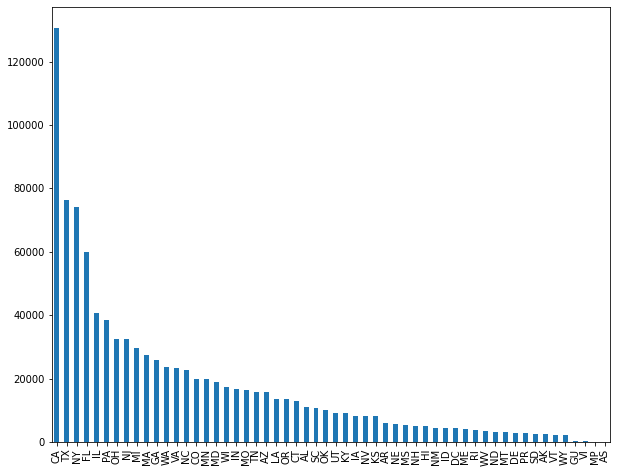

In [83]:
plt.subplots(figsize=(10,8))
state_amts.plot(kind='bar')
plt.savefig('borrowers.png')

In [85]:
print(state_amts)
state_amts.mean()

CA    130616
TX     76183
NY     74110
FL     60035
IL     40813
PA     38535
OH     32646
NJ     32535
MI     29802
MA     27473
GA     25832
WA     23754
VA     23267
NC     22826
CO     19742
MN     19729
MD     18977
WI     17353
IN     16601
MO     16350
TN     15869
AZ     15794
LA     13668
OR     13456
CT     12892
AL     10912
SC     10742
OK      9997
UT      9294
KY      9179
IA      8295
NV      8262
KS      8202
AR      5857
NE      5804
MS      5502
NH      5078
HI      4980
NM      4485
ID      4416
DC      4399
ME      4185
RI      3792
WV      3365
ND      3222
MT      3144
DE      2996
PR      2952
SD      2695
AK      2663
VT      2269
WY      2139
GU       443
VI       290
MP        82
AS        20
Name: BorrowerState, dtype: int64


17294.98214285714

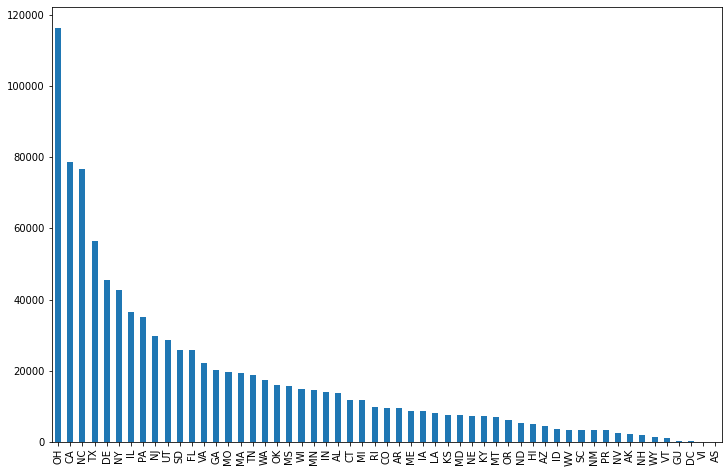

In [77]:
state_count = df['OriginatingLenderState'].value_counts()
plt.subplots(figsize=(12,8))
state_count.plot(kind='bar')
plt.savefig('stateloans.png')

In [79]:
print(state_count)
state_count.mean()

OH    116348
CA     78593
NC     76618
TX     56393
DE     45481
NY     42750
IL     36612
PA     35158
NJ     29727
UT     28779
SD     25814
FL     25767
VA     22195
GA     20374
MO     19615
MA     19412
TN     18892
WA     17408
OK     16065
MS     15790
WI     14827
MN     14759
IN     14085
AL     13849
CT     11777
MI     11743
RI      9881
CO      9702
AR      9549
ME      8762
IA      8625
LA      8301
KS      7579
MD      7564
NE      7442
KY      7413
MT      6985
OR      6312
ND      5301
HI      5196
AZ      4566
ID      3610
WV      3312
SC      3306
NM      3301
PR      3281
NV      2441
AK      2193
NH      1983
WY      1287
VT      1098
GU       341
DC       302
VI        53
AS        15
Name: OriginatingLenderState, dtype: int64


17609.672727272726